# Importing Libraries

In [617]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import shap
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_curve, auc

# Data Preprocessing and Cleaning

In [618]:
df_sub = pd.read_csv("subscriptions_merged.csv") #merged file between original subscriptions_mix and the new subscriptions_60K
trans_df = pd.read_csv("new_transactions.csv") #transactional dataset from lumoshive

Columns (5,7,11,14,17,21,23,24) have mixed types. Specify dtype option on import or set low_memory=False.
Columns (4,6,14,15,16,19,20) have mixed types. Specify dtype option on import or set low_memory=False.


In [619]:
print(df_sub.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 365614 entries, 0 to 365613
Data columns (total 27 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   Unnamed: 0         365614 non-null  int64 
 1   id                 365614 non-null  int64 
 2   created_at         365614 non-null  object
 3   country            365614 non-null  object
 4   operator           365614 non-null  object
 5   service            365614 non-null  object
 6   source             354366 non-null  object
 7   msisdn             365614 non-null  object
 8   status             365614 non-null  int64 
 9   cycle              365613 non-null  object
 10  adnet              177233 non-null  object
 11  revenue            365614 non-null  object
 12  subs_date          365614 non-null  object
 13  renewal_date       365581 non-null  object
 14  freemium_end_date  221176 non-null  object
 15  unsubs_from        88987 non-null   object
 16  unsubs_date        1

In [620]:
df_sub.isna().sum()

Unnamed: 0                0
id                        0
created_at                0
country                   0
operator                  0
service                   0
source                11248
msisdn                    0
status                    0
cycle                     1
adnet                188381
revenue                   0
subs_date                 0
renewal_date             33
freemium_end_date    144438
unsubs_from          276627
unsubs_date          227824
service_price             0
currency              18465
profile_status        44997
publisher            232303
trxid                212498
pixel                264575
handset              255490
browser              246449
attempt_charging          0
success_billing           0
dtype: int64

In [621]:
drop = [  
    "Unnamed: 0",
    "id",   
    "created_at",
    "pixel",     
    "browser",
    "handset",
    "msisdn",
    "trxid",
    "publisher" 
]

check = ((df_sub['subs_date'] > df_sub['unsubs_date'])) 

df_sub.drop(df_sub.index[2], inplace=True) 
df_sub.drop(columns = drop, inplace=True) 
df_sub.drop(check[check].index, inplace=True) 

df_sub


,country,operator,service,source,status,cycle,adnet,revenue,subs_date,renewal_date,freemium_end_date,unsubs_from,unsubs_date,service_price,currency,profile_status,attempt_charging,success_billing
0,TH,ais,459505104,sms,0,daily,NaN,0,2022-10-20 19:28:02.000,2023-09-14 00:00:00.000,2022-10-20 00:00:00.000,NaN,NaN,6,BATH,Active,15,0
1,TH,ais,459505104,sms,0,daily,NaN,0,2020-08-23 16:11:02.000,2023-09-14 00:00:00.000,2020-08-23 00:00:00.000,NaN,NaN,6,BATH,Active,15,0
3,TH,ais,459505105,wap,0,daily,star,0,2023-09-09 13:03:24.000,2023-09-14 00:00:00.000,2023-09-09 00:00:00.000,NaN,NaN,6,BATH,Active,5,0
4,TH,ais,459505104,sms,0,daily,NaN,0,2022-09-26 19:36:03.000,2023-09-14 00:00:00.000,2022-09-26 00:00:00.000,NaN,NaN,6,BATH,Active,15,0
5,TH,ais,459505106,sms,0,daily,NaN,0,2021-08-06 16:27:07.000,2023-09-14 00:00:00.000,2021-08-06 00:00:00.000,NaN,NaN,6,BATH,Active,15,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
365609,TH,ais,459509903,sms,0,daily,NaN,0,20:10.0,00:00.0,00:00.0,NaN,NaN,6,BATH,Active,0,0
365610,TH,ais,459505105,wap,1,daily,mpl,0,07:04.0,00:00.0,00:00.0,NaN,NaN,6,BATH,Active,35,0
365611,TH,aisgemezz,GE,SMS,1,daily,BTM,0,37:27.0,00:00.0,00:00.0,NaN,NaN,0,BAHT,Active,112,14
365612,TH,ais,459509903,sms,0,daily,NaN,0,20:04.0,00:00.0,00:00.0,NaN,NaN,6,BATH,Active,0,0


In [622]:
df_sub.isna().sum()

country                   0
operator                  0
service                   0
source                10283
status                    0
cycle                     1
adnet                187301
revenue                   0
subs_date                 0
renewal_date             33
freemium_end_date     75724
unsubs_from          247218
unsubs_date          227823
service_price             0
currency              17473
profile_status        33026
attempt_charging          0
success_billing           0
dtype: int64

In [623]:
df_sub.dropna(subset=['country', 'operator', 'service', 'status', 'cycle', 'revenue', 'subs_date', 'renewal_date', 'service_price', 'attempt_charging', 'success_billing'], inplace=True)
df_sub.isna().sum()

country                   0
operator                  0
service                   0
source                10250
status                    0
cycle                     0
adnet                187267
revenue                   0
subs_date                 0
renewal_date              0
freemium_end_date     75690
unsubs_from          247217
unsubs_date          227822
service_price             0
currency              17440
profile_status        32993
attempt_charging          0
success_billing           0
dtype: int64

In [624]:
df_sub['operator'].unique()

array(['ais', 'sen-orange-mtarget', 'etl', 'tplus', 'ltc', 'LTC',
       'omantel', 'id-telkomsel-mks', 'telesatpass', 'telkomsel',
       'smartfren', 'smart', 'aisgemezz'], dtype=object)

In [625]:
df_sub['operator'].unique()

new_val = {"LTC" : "ltc"}

df_sub['operator'].replace(new_val, inplace=True)

In [626]:
print(df_sub['source'].unique())

for src in df_sub['source']:
    print(src)

['sms' 'wap' 'ivr' 'web' nan 'USSD' 'cp1' 'lp3' 'lp1' 'SMS' 'lp4'
 'mo_ussd' 'lp6' 'mo_sms' 'portal' 'USSD_W' 'USSD_D' 'WAP' 'default']
sms
sms
wap
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
wap
sms
sms
sms
sms
wap
sms
sms
wap
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
sms
sms
wap
sms
sms
sms
sms
wap
sms
sms
sms
sms
sms
wap
sms
sms
sms
wap
sms
sms
sms
wap


In [627]:
source_counts = df_sub.groupby(['country', 'source']).size().reset_index(name='count')
idx = source_counts.groupby('country')['count'].idxmax()
mode_sources = source_counts.loc[idx].set_index('country')['source']
mode_sources

country
ID    sms
LA    cp1
OM    cp1
PH    sms
SN    web
TH    sms
Name: source, dtype: object

In [628]:
country_mapping = {
    'ID': 'sms',
    'LA': 'cp1',
    'OM': 'cp1',
    'PH': 'sms',
    'SN': 'web',
    'TH': 'sms'
}
nan_mask = df_sub['source'].isna()
df_sub.loc[nan_mask, 'source'] = df_sub.loc[nan_mask, 'country'].map(country_mapping)

In [629]:
new_values = {"SMS" : "sms",
              "WAP" : "wap"}

df_sub['source'].replace(new_values, inplace=True)

In [630]:
df_sub['source'].value_counts()

source
sms        204995
cp1         50696
wap         21399
web         12357
USSD         3053
lp3          3051
mo_ussd       853
USSD_D        174
USSD_W        133
portal         52
lp6            11
lp1             7
ivr             5
lp4             2
mo_sms          1
default         1
Name: count, dtype: int64

In [631]:
for every_currency in df_sub['currency']:
    print(every_currency)

print(df_sub['currency'].unique())
print(df_sub['country'].unique())

BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH


In [632]:
correct_currency = {"BATH" : "BAHT", 
                    "Kip" : "LAK"}

df_sub['currency'].replace(correct_currency, inplace=True)

country_currency = {'SN': 'XOF', 'ID': 'IDR'}
df_sub['currency'] = df_sub['country'].map(country_currency).fillna(df_sub['currency'])

In [633]:
df_sub['currency'].isna().sum()

0

In [634]:
df_sub['currency'].value_counts()

currency
BAHT    209926
LAK      42485
Rial     15554
XOF      12357
PHP       9998
IDR       6470
Name: count, dtype: int64

In [635]:
df_sub.isna().sum()

country                   0
operator                  0
service                   0
source                    0
status                    0
cycle                     0
adnet                187267
revenue                   0
subs_date                 0
renewal_date              0
freemium_end_date     75690
unsubs_from          247217
unsubs_date          227822
service_price             0
currency                  0
profile_status        32993
attempt_charging          0
success_billing           0
dtype: int64

In [636]:
print("revenue generated= ", df_sub['revenue'].unique())
print("service price = ", df_sub['service_price'].unique())

revenue generated=  [0 12 6 90 18 66 180 24 72 30 42 48 162 60 36 132 54 84 96 78 120 168 102
 138 144 150 '0' '6' '18' '12' '24' '54' '66' '78' '30' '48' '150'
 '150:00:00' '0:00' '20000' '1000' '2000' '4000' '8000' '15000' '6000'
 '10000' '9000' '26000' '18000' '5000' '12000' '30000' '40000' '54000'
 '24000' '48000' '16000' '28000' '34000' '36000' '22000' '14000' '41000'
 '13000' '37000' '39000' '42000' '17000' '25000' '38000' '3000' '72000'
 '50000' '73000' '44000' '29000' '7000' '27000' '23000' '19000' '11000'
 '60000' '21000' '32000' '74000' '62000' '31000' '66000' '45000' '70000'
 '65000' '35000' '33000' '82000' '81000' '53000' '58000' '68000' '57000'
 '64000' '47000' '93000' '76000' '43000' '56000' '112000' '67000' '78000'
 '153000' '52000' '104000' '51000' '55000' '46000' '118000' '80000'
 '79000' '49000' '142000' '61000' '69000' '59000' '152000' '122000'
 '63000' '124000' '121000' '86000' '102000' '106000' '288000' '194000'
 '190000' '110000' '83000' '115000' '100000' '134000'

In [637]:
date_to_int = {
    "150:00:00" : 150, #new values to convert this 'datelike' format into num
    "0:00"      : 0
}

price_changes = {
    '10000.00'   : 10000, 
    '2000:00:00' : 2000, 
    '1000:00:00' : 1000,
}

df_sub['revenue'] = df_sub['revenue'].replace(date_to_int) #replacing the datelike format to integer
df_sub['service_price'] = df_sub['service_price'].replace(price_changes)

In [638]:
df_sub['profile_status'].unique()


array(['Active', 'Unsub', nan, 'inactive', 'active', 'FALSE', 'Grace',
       'Purge'], dtype=object)

In [639]:
df_sub['profile_status'] = df_sub['profile_status'].fillna(df_sub['profile_status'].map({-1: 'inactive', 0: 'active', 1: 'active'}))

In [640]:
df_sub['profile_status'].value_counts()

profile_status
Active      209931
active       36490
Grace         8102
inactive      6205
Unsub         2391
Purge          676
FALSE            2
Name: count, dtype: int64

In [641]:
new_values = {"Active" : "active",
              "Unsub" : "inactive",
              "Grace" : "inactive",
              "Purge" : "inactive",
              "False" : np.nan}

df_sub['profile_status'].replace(new_values, inplace=True)

In [642]:
df_sub['profile_status'].value_counts()

profile_status
active      246421
inactive     17374
FALSE            2
Name: count, dtype: int64

In [643]:
for i in df_sub['subs_date'].unique():
    print(i)

2022-10-20 19:28:02.000
2020-08-23 16:11:02.000
2023-09-09 13:03:24.000
2022-09-26 19:36:03.000
2021-08-06 16:27:07.000
2023-01-01 03:02:04.000
2023-06-23 23:26:04.000
2021-07-23 16:40:11.000
2022-06-16 09:51:02.000
2021-05-18 19:14:02.000
2022-09-07 15:50:04.000
2023-02-17 02:43:02.000
2022-09-05 01:59:03.000
2022-02-05 04:05:03.000
2022-10-01 14:33:03.000
2022-06-07 17:23:05.000
2021-05-25 18:47:02.000
2022-02-08 06:17:03.000
2022-10-01 15:42:03.000
2021-09-20 15:14:03.000
2022-08-15 15:31:03.000
2021-11-12 00:18:04.000
2021-04-29 15:21:01.000
2022-09-26 22:29:02.000
2021-05-07 20:32:01.000
2022-11-17 14:36:03.000
2021-09-12 15:01:28.000
2023-01-18 02:06:02.000
2022-06-09 01:07:02.000
2022-02-08 21:24:03.000
2023-09-09 08:50:27.000
2022-09-07 18:13:04.000
2023-08-14 23:06:05.000
2021-09-19 16:46:04.000
2022-10-18 15:33:04.000
2021-09-21 15:37:01.000
2022-02-08 03:25:03.000
2023-06-26 02:52:03.000
2022-05-26 18:30:04.000
2021-07-17 02:37:02.000
2023-09-01 05:55:45.000
2023-05-30 01:38

In [644]:
df_sub['attempt_charging'] = df_sub['attempt_charging'].astype(int) #assign dtypes for attribute that might be used later
df_sub['success_billing'] = df_sub['success_billing'].astype(int)
df_sub['service_price'] = df_sub['service_price'].astype(int)
df_sub['revenue'] = df_sub['revenue'].astype(int)
df_sub['status'] = df_sub['status'].astype(int)
df_sub['subs_date'] = pd.to_datetime(df_sub['subs_date'], errors="coerce")
df_sub['renewal_date'] = pd.to_datetime(df_sub['renewal_date'], errors='coerce')
df_sub['freemium_end_date'] = pd.to_datetime(df_sub['freemium_end_date'], errors='coerce')
df_sub['unsubs_date'] = pd.to_datetime(df_sub['unsubs_date'], errors='coerce')
df_sub['service'] = df_sub['service'].astype(str)

In [645]:
df_sub.dtypes

country                      object
operator                     object
service                      object
source                       object
status                        int32
cycle                        object
adnet                        object
revenue                       int32
subs_date            datetime64[ns]
renewal_date         datetime64[ns]
freemium_end_date    datetime64[ns]
unsubs_from                  object
unsubs_date          datetime64[ns]
service_price                 int32
currency                     object
profile_status               object
attempt_charging              int32
success_billing               int32
dtype: object

In [646]:
def ConvertToUSD(index: str):
    conversion_rate = {
               'BAHT' : 0.029,
               'LAK'  : 0.000049,
               'Rial' : 2.60,
               "Baisa" : 0.00260,
               'XOF'  : 0.0017,
               'PHP'  : 0.018,
               'IDR'  : 0.000065}
    
    if index in conversion_rate:
        return conversion_rate[index]
    
df_sub['revenue_in_USD'] = df_sub['currency'].apply(ConvertToUSD) * df_sub['revenue']
df_sub['service_price_in_USD'] = df_sub['currency'].apply(ConvertToUSD) * df_sub['service_price']    

In [647]:
df_sub.isna().sum()

country                      0
operator                     0
service                      0
source                       0
status                       0
cycle                        0
adnet                   187267
revenue                      0
subs_date                42285
renewal_date             42452
freemium_end_date        96794
unsubs_from             247217
unsubs_date             250622
service_price                0
currency                     0
profile_status           32993
attempt_charging             0
success_billing              0
revenue_in_USD               0
service_price_in_USD         0
dtype: int64

In [648]:
df_sub['adnet'] = df_sub['adnet'].astype(str).apply(lambda i: i.split("-")[0].lower())
df_sub['adnet'] = df_sub['adnet'].replace("nan", np.nan)
df_sub['adnet'].unique()

array([nan, 'star', 'mpl', 'lig', 'mbv', 'svr', 'btm', 'mbp', 'mov',
       'sco', 'soy', 'sdt', 'bads', 'ven', 'mbvs', 'mgm', 'aiscm', 'yms',
       'zbl', 'hmb', 'atn', 'wmb', 'dsr', 'default', 'marvel', 'mvl',
       'test', 'outrix', 'zia', 'mobip', 'adm', 'waki', 'ads', 'app',
       'movi', 'glk', 'avr', 'ozo', 'olimob', 'ais', 'kee', 'fmd', 'adg',
       'adn', 'stp', 'vad', 'prt', 'rcl', 'cad', 'mdea', 'wit', 'dsl',
       'goa', 'ggs', 'adc', 'drg', 'him', 'ogt', 'mjm', 'apd', 'dch',
       'revl', 'mbt', 'hrm', 'mtu', 'tfc', 'mbk', 'mvls', 'acr', 'hfm',
       'dlt', 'adl', 'haf', 'cbt'], dtype=object)

In [649]:
df_sub['service'].value_counts()

service
459505104     46646
459509902     43379
gemezz        42996
459505106     37991
459505105     30942
459509903     25007
459509901     22291
goaly         15554
slypee        10143
10291          8040
GE             3169
10292          1953
SLYPEE FSC     1861
slypee fsc     1515
quizy          1092
GAMESPOT        648
SLYPEE DFS      609
halogame        596
PLAYZONE        513
slypee dfs      434
GAMESC LKT      366
FUN1            298
GEF             184
CLOUDPLAY       163
GEA              99
GED              70
GE7              57
QUIZPRO          48
GE7A             33
GEB              29
GEE              18
Halogame         15
GAZY             10
GEC              10
GMSPAZE           5
9109              5
GE1               1
Name: count, dtype: int64

In [650]:
new_values = {"SLYPEE DFS" : "slypee", 
              "SLYPEE FSC" : "slypee", 
              "slypee fsc" : "slypee",
              "slypee dfs" : "slypee",
              "459509901" : "45950991",
              "459505105" : "459505105",
              "459509903" : "459509903",
              "459505104" : "459505104",
              "Halogame" : "halogame",
              'GEE' : "GE", 'GED' : "GE", 'GEA' : "GE", 'GE7' : "GE", 'GEF' : "GE", 'GE7A' : "GE", 'GEC' : "GE",
       'GEB' : "GE", 'GE1' : "GE"}

df_sub['service'].replace(new_values, inplace=True)

In [651]:
df_sub['service'].unique()

array(['459505104', '459505105', '459505106', '459509902', '459509903',
       '45950991', 'gemezz', 'slypee', 'halogame', 'goaly', 'PLAYZONE',
       'GAMESPOT', 'CLOUDPLAY', 'GAMESC LKT', 'FUN1', 'QUIZPRO', 'GAZY',
       'GMSPAZE', 'quizy', '10291', '10292', '9109', 'GE'], dtype=object)

In [652]:
df_sub['monthly_subs'] = df_sub['subs_date'].dt.month
df_sub['yearly_subs'] = df_sub['subs_date'].dt.year
df_sub['hourly_subs'] = df_sub['subs_date'].dt.hour

df_sub['monthly_unsubs'] = df_sub['unsubs_date'].dt.month
df_sub['yearly_unsubs'] = df_sub['unsubs_date'].dt.year
df_sub['hourly_unsubs'] = df_sub['unsubs_date'].dt.hour

df_sub['monthly_renewal'] = df_sub['renewal_date'].dt.month
df_sub['hourly_renewal'] = df_sub['renewal_date'].dt.hour

df_sub['success_billing_rate'] = (df_sub['success_billing'] / df_sub['attempt_charging']) * 100
df_sub['failed_attempts_rate'] = 100 - df_sub['success_billing_rate']
df_sub['is_declining'] = np.where((df_sub['status'] == -1), 1, 0)

In [653]:
df_sub['status'].value_counts()

status
 0    225689
 1     42641
-1     28372
 2        88
Name: count, dtype: int64

In [654]:
df_sub['is_declining'].value_counts()

is_declining
0    268418
1     28372
Name: count, dtype: int64

In [655]:
df_sub['revenue_in_USD'].fillna(0, inplace=True)
df_sub['revenue_in_USD'] = df_sub['revenue_in_USD'].astype(int)
df_sub['service_price_in_USD'].fillna(0, inplace=True)
df_sub['service_price_in_USD'] = df_sub['service_price_in_USD'].astype(int)

In [656]:
columns_to_keep = ['is_declining', "adnet", "service", "source", "operator", "country", "attempt_charging"]
subscriptions_cleaned = df_sub[columns_to_keep].dropna()

In [657]:
subscriptions_cleaned

,is_declining,adnet,service,source,operator,country,attempt_charging
3,0,star,459505105,wap,ais,TH,5
6,0,star,459505106,sms,ais,TH,15
7,0,mpl,459505105,wap,ais,TH,15
12,0,mpl,459505104,sms,ais,TH,15
28,0,star,459509902,sms,ais,TH,0
...,...,...,...,...,...,...,...
365582,0,btm,GE,sms,aisgemezz,TH,146
365599,0,star,459505105,wap,ais,TH,35
365610,0,mpl,459505105,wap,ais,TH,35
365611,0,btm,GE,sms,aisgemezz,TH,112


# Transactional Data

In [658]:
print(trans_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 510867 entries, 0 to 510866
Data columns (total 21 columns):
 #   Column              Non-Null Count   Dtype 
---  ------              --------------   ----- 
 0   id                  510867 non-null  int64 
 1   created_at          510867 non-null  object
 2   country             510867 non-null  object
 3   operator            510867 non-null  object
 4   service             510867 non-null  object
 5   source              480320 non-null  object
 6   msisdn              510867 non-null  object
 7   event               510867 non-null  object
 8   event_date          510867 non-null  object
 9   cycle               510867 non-null  object
 10  revenue             510867 non-null  int64 
 11  currency            480373 non-null  object
 12  charge_date         510867 non-null  object
 13  publisher           251899 non-null  object
 14  handset             178651 non-null  object
 15  browser             199576 non-null  object
 16  tr

In [659]:
trans_df.isna().sum()

id                         0
created_at                 0
country                    0
operator                   0
service                    0
source                 30547
msisdn                     0
event                      0
event_date                 0
cycle                      0
revenue                    0
currency               30494
charge_date                0
publisher             258968
handset               332216
browser               311291
trxid                 200700
telco_api_url          33919
telco_api_response     46996
sms_content           230590
status_sms            200084
dtype: int64

In [660]:
cols = {
    'browser', 
    'handset',  
    'sms_content', 
    'trxid', 
    'telco_api_response', 
    'msisdn',
    'publisher',
    'telco_api_url',
    'status_sms'
}

trans_df.drop(columns=cols, inplace=True)


In [661]:
print(trans_df['currency'].unique())
print(trans_df['country'].unique())

['IDR' nan 'LAK' 'Rial' 'Baisa' 'BATH' 'BAHT' 'PHP']
['ID' 'LA' 'OM' 'TH' 'PH' 'SN']


In [662]:
for i in trans_df['currency']:
    print(i)

IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
nan
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
nan
IDR
IDR
IDR
IDR
IDR
IDR
IDR


In [663]:
correct_currency = {"BATH" : "BAHT"}

trans_df['currency'].replace(correct_currency, inplace=True)

country_currency = {'TH': "BAHT", 'SN': 'XOF', 'LA': 'LAK', 'ID': 'IDR', 'PH': 'PHP'}
trans_df['currency'] = trans_df.apply(lambda row: country_currency.get(row['country'], row['currency']), axis=1)


In [664]:
trans_df.isna().sum()

id                 0
created_at         0
country            0
operator           0
service            0
source         30547
event              0
event_date         0
cycle              0
revenue            0
currency           0
charge_date        0
dtype: int64

In [665]:
trans_df['currency'].unique()

array(['IDR', 'LAK', 'Rial', 'Baisa', 'BAHT', 'PHP', 'XOF'], dtype=object)

In [666]:
trans_df['revenue_in_USD'] = trans_df['currency'].apply(ConvertToUSD) * trans_df['revenue']

In [667]:
trans_df['charge_date'] = pd.to_datetime(trans_df['charge_date'], errors='coerce')
trans_df['event_date'] = pd.to_datetime(trans_df['event_date'], errors='coerce')

In [668]:
trans_df['monthly_charge_date'] = trans_df['charge_date'].dt.month
trans_df['yearly_charge_date'] = trans_df['charge_date'].dt.year
trans_df['hourly_charge_date'] = trans_df['charge_date'].dt.hour

In [669]:
trans_df['event'].unique()

array(['RENEWAL', 'Retry Renewal', 'renewal', 'FIRSTPUSH', 'UNSUB',
       'Renewal', 'Subscription', 'Unsubscription', 'retry renewal',
       'subscribe@portal', 'subscribe-nb@cp1', 'renewal-nb@cp1', 'retry',
       'retry@mo_ussd', 'renewal@mo_ussd', 'renewal@charge',
       'charge-nb@cp1', 'renewal@cp1', 'retry@portal', 'subscribe-nb',
       'USSD_W@charge', 'USSD_D@charge', 'subscribe-nb@cp1_confirm',
       'retry@cp1', 'subscription', 'renewal-nb@cp1_confirm',
       'renewal@portal', 'retry@lp6', 'charge-nb', 'renewal@lp6',
       'renewal@mo_sms', 'subscribe', 'subscribe@lp1{${sleep(20)}}',
       'subscribe@(select*from(select(sleep(20)))a)',
       'subscribe@*)(!(objectClass=*)', 'subscribe@lp1',
       'subscribe@portal_confirm', 'retry@lp7', 'notif@renew', 'notif@mt',
       'unsubscribe', 'Trial'], dtype=object)

In [670]:
trans_df['source']

0         WAP
1         WAP
2         WAP
3         WAP
4         WAP
         ... 
510862    NaN
510863    NaN
510864    NaN
510865    NaN
510866    NaN
Name: source, Length: 510867, dtype: object

In [671]:
df_sub['revenue_in_USD'].unique()

array([     0,      2,      1,      5,      4,      3,      7,      6,
           14,      9,     12,     10,     17,      8,     15,     16,
           13,     11,     24,     18,     22,     19,    780,  42900,
         2340,   6240,   9360,  28860,   3900,   1560,   3120,  21060,
        24960,  18720,   4680,   5460,  59280,  22620,  89700,  85800,
        15600,  52260,  14040,  85020,  28080,  56940,  38220,  16380,
        63180,  34320,  32760,  13260,  10920,   7800,  27300,  21840,
        29640,  14820,  10140,   7020,  43680,   8580,  90480,  45240,
        41340,  25740,  48360,  31200,  76440,  33540,  37440,  39000,
        31980,  24180,  20280,  46020,  39780,  17160,  47580,  69420,
        26520,  73320,  11700, 134940,  95160,  17940,  62400,  67860,
        30420,  58500,  66300,  61620,  99060,  42120,  79560,  82680,
        23400, 117780,  44460,  12480,  35880, 113880,  53820,  19500,
        63960,  81900,  55380,  49920,  88140,  60060, 102960,  84240,
      

# Data Visualization

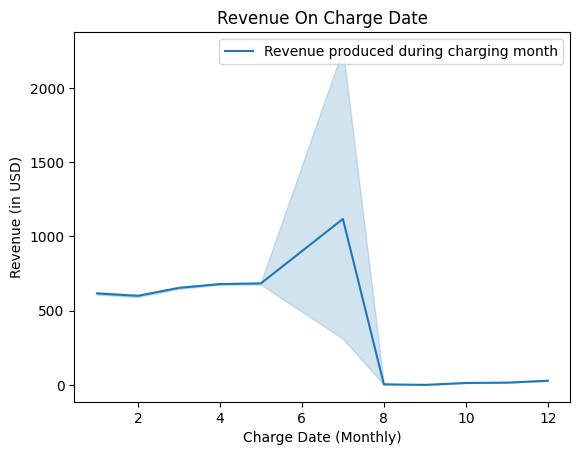

In [672]:
sns.lineplot(data= trans_df, x='monthly_charge_date', y='revenue_in_USD', label="Revenue produced during charging month")
plt.title("Revenue On Charge Date")
plt.xlabel("Charge Date (Monthly)")
plt.ylabel("Revenue (in USD)")
plt.show()

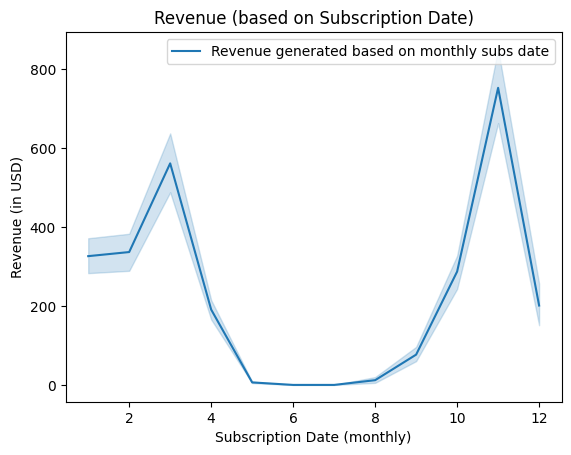

In [673]:
sns.lineplot(data= df_sub, x='monthly_subs', y='revenue_in_USD', label="Revenue generated based on monthly subs date")
plt.title("Revenue (based on Subscription Date)")
plt.xlabel("Subscription Date (monthly)")
plt.ylabel("Revenue (in USD)")
plt.show()

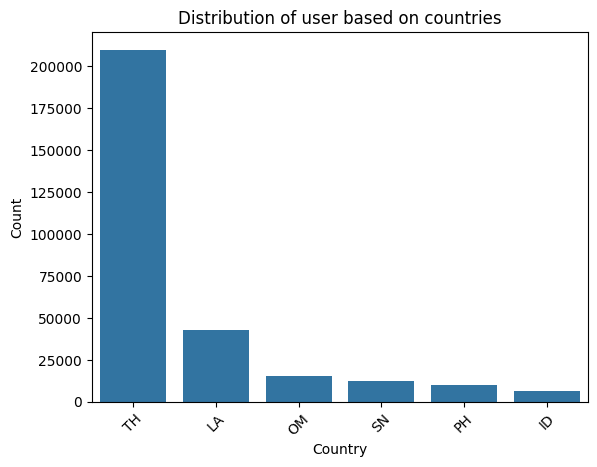

In [674]:
sns.countplot(x='country', data=df_sub, order=df_sub['country'].value_counts().index)
plt.xticks(rotation=45)
plt.title('Distribution of user based on countries')
plt.xlabel('Country')
plt.ylabel('Count')

plt.show()

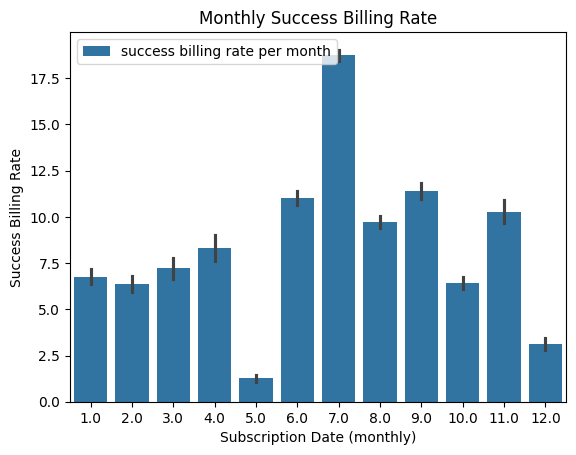

In [675]:
sns.barplot(data= df_sub, x='monthly_subs', y='success_billing_rate', label="success billing rate per month")
plt.title("Monthly Success Billing Rate")
plt.xlabel("Subscription Date (monthly)")
plt.ylabel("Success Billing Rate")
plt.show()


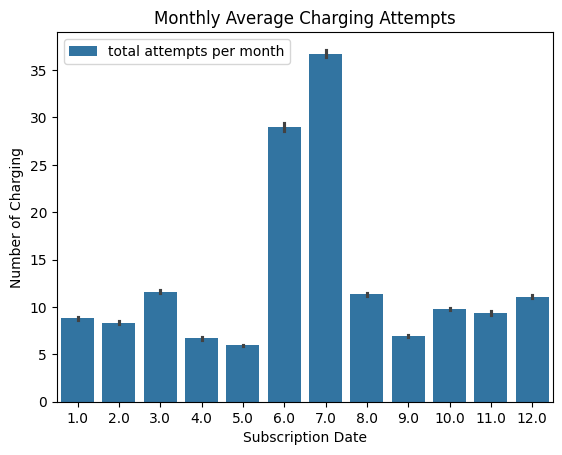

In [676]:
sns.barplot(data= df_sub, x='monthly_subs', y='attempt_charging', label="total attempts per month")
plt.title("Monthly Average Charging Attempts")
plt.xlabel("Subscription Date")
plt.ylabel("Number of Charging")
plt.show()

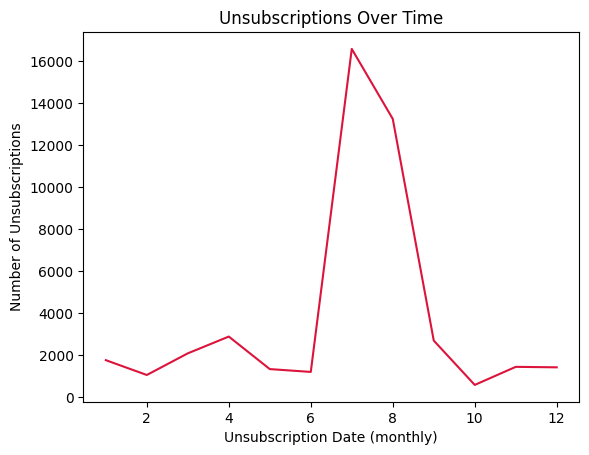

In [677]:
unsubs_by_month = df_sub.groupby('monthly_unsubs').size()
unsubs_by_month.plot(kind='line', color='crimson')
plt.title('Unsubscriptions Over Time')
plt.xlabel('Unsubscription Date (monthly)')
plt.ylabel('Number of Unsubscriptions')
plt.show()


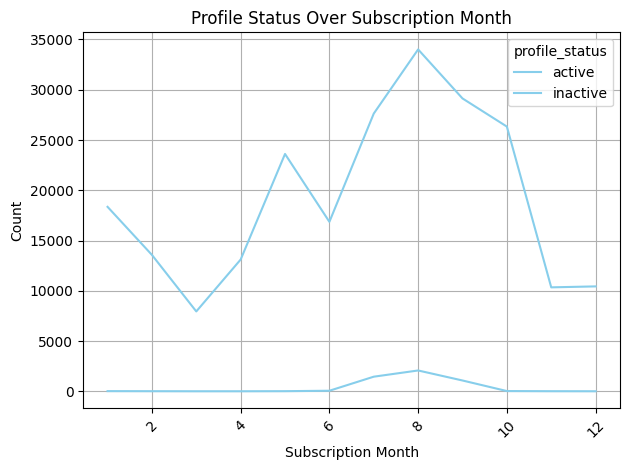

In [678]:
status_count = df_sub.groupby(['monthly_subs', 'profile_status']).size().unstack(fill_value=0)
status_count.plot(kind='line', color='skyblue')
plt.xlabel("Subscription Month")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.title("Profile Status Over Subscription Month")
plt.tight_layout()
plt.grid(True)
plt.show()

# Data Models

In [679]:
subscriptions_cleaned.drop_duplicates(inplace=True)

In [680]:
subscriptions_cleaned

,is_declining,adnet,service,source,operator,country,attempt_charging
3,0,star,459505105,wap,ais,TH,5
6,0,star,459505106,sms,ais,TH,15
7,0,mpl,459505105,wap,ais,TH,15
12,0,mpl,459505104,sms,ais,TH,15
28,0,star,459509902,sms,ais,TH,0
...,...,...,...,...,...,...,...
365293,0,hfm,GE,sms,aisgemezz,TH,91
365382,0,btm,GE,sms,aisgemezz,TH,165
365496,0,sco,GE,sms,aisgemezz,TH,9
365536,0,vad,GE,sms,aisgemezz,TH,142


In [681]:
subscriptions_cleaned['is_declining'].value_counts()

is_declining
0    2422
1     946
Name: count, dtype: int64

In [682]:
label = LabelEncoder()

subscriptions_cleaned['country'] = label.fit_transform(subscriptions_cleaned['country'])
subscriptions_cleaned['operator'] = label.fit_transform(subscriptions_cleaned['operator'])
subscriptions_cleaned['service'] = label.fit_transform(subscriptions_cleaned['service'])
subscriptions_cleaned['adnet'] = label.fit_transform(subscriptions_cleaned['adnet'])
subscriptions_cleaned['source'] = label.fit_transform(subscriptions_cleaned['source'])

### Random Forest Classification

Model Accuracy      : 0.8694
Model Precision     : 0.8175
Model Recall Score  : 0.7055
Model F1 Score      : 0.7574


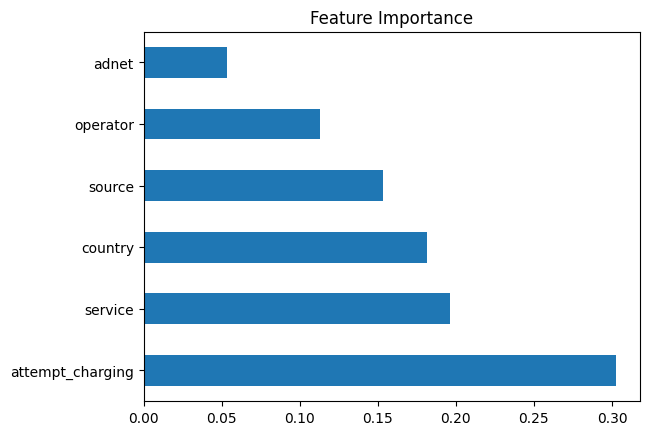

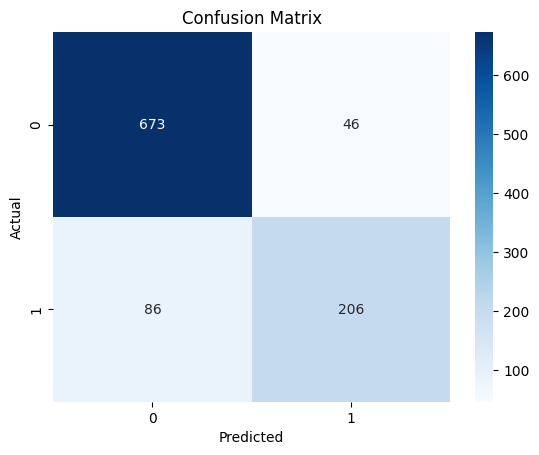

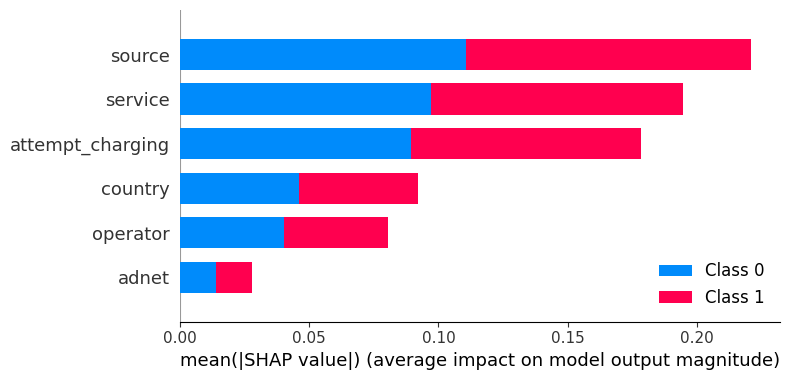

In [692]:
X = subscriptions_cleaned[["adnet", "service", "source", "attempt_charging", "operator", "country"]]
y = subscriptions_cleaned['is_declining']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

rfc = RandomForestClassifier(max_depth=10, criterion='gini')
rfc.fit(X_train, y_train)

y_pred = rfc.predict(X_test)

acc_score = accuracy_score(y_test, y_pred)
prec_score = precision_score(y_test, y_pred)
rec_score = recall_score(y_test, y_pred)
f1_scr = f1_score(y_test, y_pred)

print(f"Model Accuracy      : {acc_score:.4f}")
print(f"Model Precision     : {prec_score:.4f}")
print(f"Model Recall Score  : {rec_score:.4f}")
print(f"Model F1 Score      : {f1_scr:.4f}")

feature_importances = pd.Series(rfc.feature_importances_, index=X.columns)
feature_importances.nlargest(10).plot(kind='barh')  # Adjust the number of features to display as needed
plt.title('Feature Importance')
plt.show()

cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap="Blues", cbar="false")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title('Confusion Matrix')
plt.show()

explainer = shap.TreeExplainer(rfc)
shap_values = explainer.shap_values(X_test)

shap.summary_plot(shap_values, X_test)


### Decision Tree Classifier

Model Accuracy      : 0.8437
Model Precision     : 0.7028
Model Recall Score  : 0.7336
Model F1 Score      : 0.7179


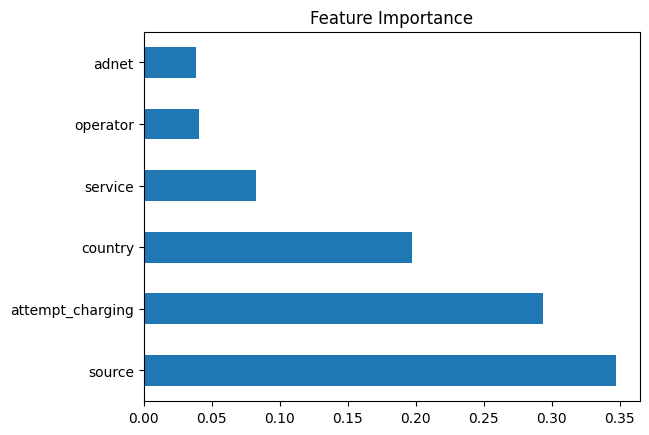

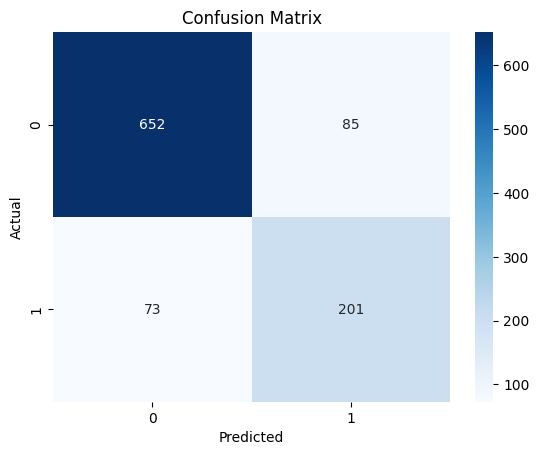

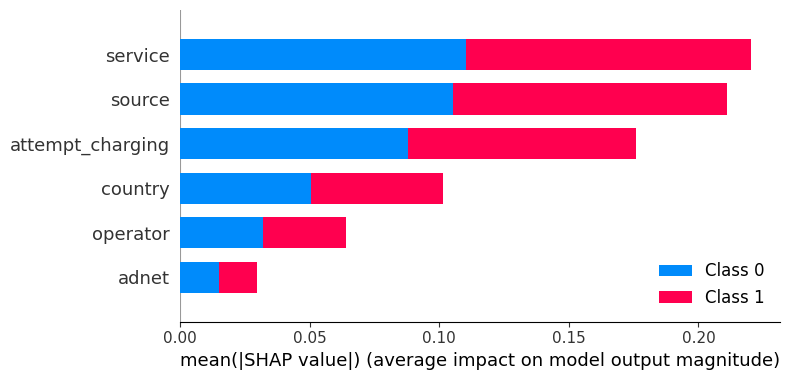

In [684]:
X = subscriptions_cleaned[["adnet", "service", "source", "attempt_charging", "operator", "country"]]
y = subscriptions_cleaned['is_declining']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

dtc = DecisionTreeClassifier(max_depth=10, criterion='gini')
dtc.fit(X_train, y_train)

y_pred = dtc.predict(X_test)

acc_score = accuracy_score(y_test, y_pred)
prec_score = precision_score(y_test, y_pred)
rec_score = recall_score(y_test, y_pred)
f1_scr = f1_score(y_test, y_pred)

print(f"Model Accuracy      : {acc_score:.4f}")
print(f"Model Precision     : {prec_score:.4f}")
print(f"Model Recall Score  : {rec_score:.4f}")
print(f"Model F1 Score      : {f1_scr:.4f}")

feature_importances = pd.Series(dtc.feature_importances_, index=X.columns)
feature_importances.nlargest(10).plot(kind='barh')  # Adjust the number of features to display as needed
plt.title('Feature Importance')
plt.show()

cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap="Blues", cbar="false")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title('Confusion Matrix')
plt.show()

explainer = shap.TreeExplainer(rfc)
shap_values = explainer.shap_values(X_test)

shap.summary_plot(shap_values, X_test)


### Gradient Boost Classifier

Model Accuracy      : 0.8912
Model Precision     : 0.8339
Model Recall Score  : 0.7893
Model F1 Score      : 0.8110


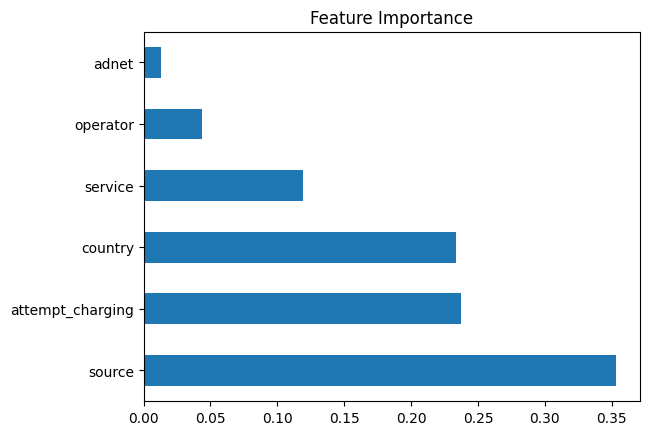

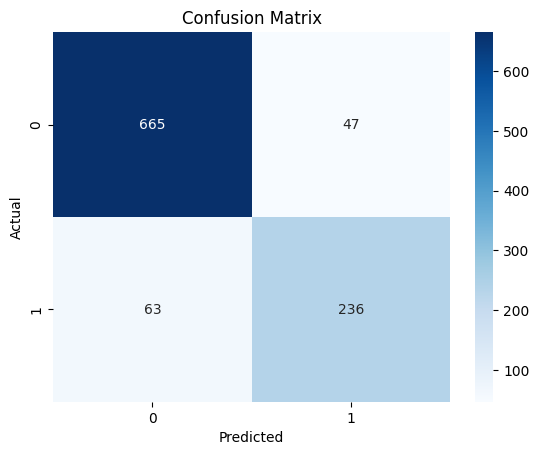

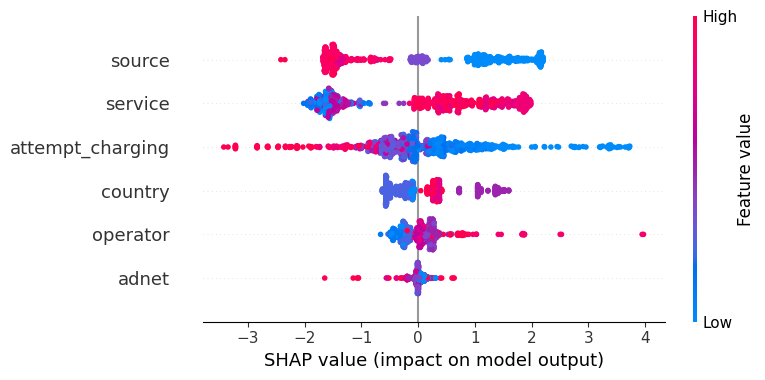

In [685]:
X = subscriptions_cleaned[["adnet", "service", "source", "attempt_charging", "operator", "country"]]
y = subscriptions_cleaned['is_declining']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

gbc = GradientBoostingClassifier(loss= "log_loss")
gbc.fit(X_train, y_train)

y_pred = gbc.predict(X_test)

acc_score = accuracy_score(y_test, y_pred)
prec_score = precision_score(y_test, y_pred)
rec_score = recall_score(y_test, y_pred)
f1_scr = f1_score(y_test, y_pred)

print(f"Model Accuracy      : {acc_score:.4f}")
print(f"Model Precision     : {prec_score:.4f}")
print(f"Model Recall Score  : {rec_score:.4f}")
print(f"Model F1 Score      : {f1_scr:.4f}")

feature_importances = pd.Series(gbc.feature_importances_, index=X.columns)
feature_importances.nlargest(10).plot(kind='barh')  # Adjust the number of features to display as needed
plt.title('Feature Importance')
plt.show()

cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap="Blues", cbar="false")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title('Confusion Matrix')
plt.show()

explainer = shap.Explainer(gbc)
shap_values = explainer.shap_values(X_test)

# Visualize SHAP values (summary plot)
shap.summary_plot(shap_values, X_test)

### K-Nearest Neighbors Classifier

Model Accuracy      : 0.8269
Model Precision     : 0.7610
Model Recall Score  : 0.6242
Model F1 Score      : 0.6858


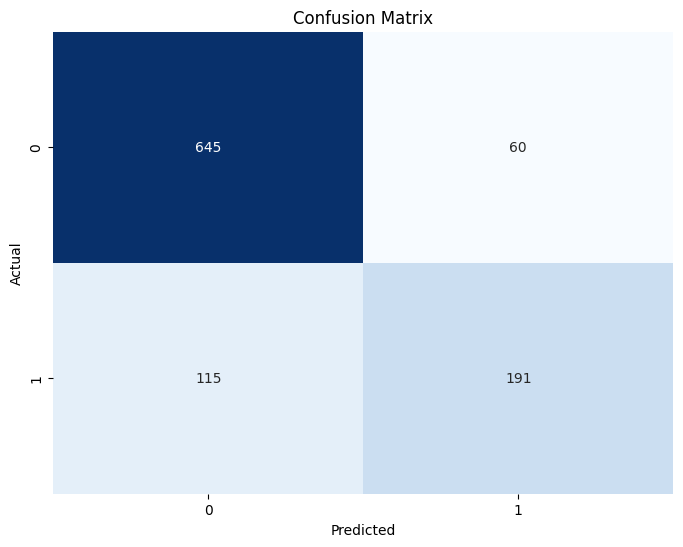

In [686]:
X = subscriptions_cleaned[["adnet", "service", "source", "attempt_charging", "operator", "country"]]
y = subscriptions_cleaned['is_declining']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)


knn = KNeighborsClassifier(n_neighbors=5, algorithm="ball_tree")  
knn.fit(X_train, y_train)


y_pred = knn.predict(X_test)
y_pred_proba = knn.predict_proba(X_test)[:, 1]  


acc_score = accuracy_score(y_test, y_pred)
prec_score = precision_score(y_test, y_pred)
rec_score = recall_score(y_test, y_pred)
f1_scr = f1_score(y_test, y_pred)

print(f"Model Accuracy      : {acc_score:.4f}")
print(f"Model Precision     : {prec_score:.4f}")
print(f"Model Recall Score  : {rec_score:.4f}")
print(f"Model F1 Score      : {f1_scr:.4f}")


cm = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

### Naive Bayes Classifier

Model Accuracy      : 0.7646
Model Precision     : 0.5708
Model Recall Score  : 0.8954
Model F1 Score      : 0.6972


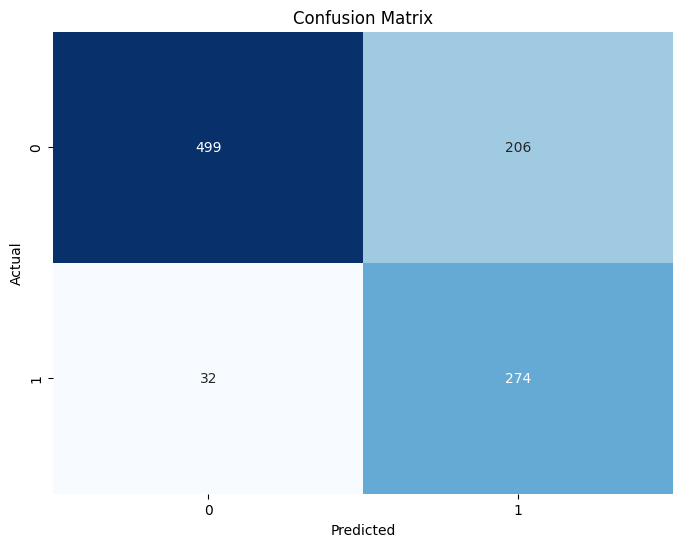

In [687]:
X = subscriptions_cleaned[["adnet", "service", "source", "attempt_charging", "operator", "country"]]
y = subscriptions_cleaned['is_declining']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

naive_bayes = GaussianNB()
naive_bayes.fit(X_train, y_train)


y_pred_proba = naive_bayes.predict_proba(X_test)[:, 1]
y_pred = naive_bayes.predict(X_test)

acc_score = accuracy_score(y_test, y_pred)
prec_score = precision_score(y_test, y_pred)
rec_score = recall_score(y_test, y_pred)
f1_scr = f1_score(y_test, y_pred)

print(f"Model Accuracy      : {acc_score:.4f}")
print(f"Model Precision     : {prec_score:.4f}")
print(f"Model Recall Score  : {rec_score:.4f}")
print(f"Model F1 Score      : {f1_scr:.4f}")


cm = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


Model Accuracy      : 0.8239
Model Precision     : 0.7581
Model Recall Score  : 0.6144
Model F1 Score      : 0.6787


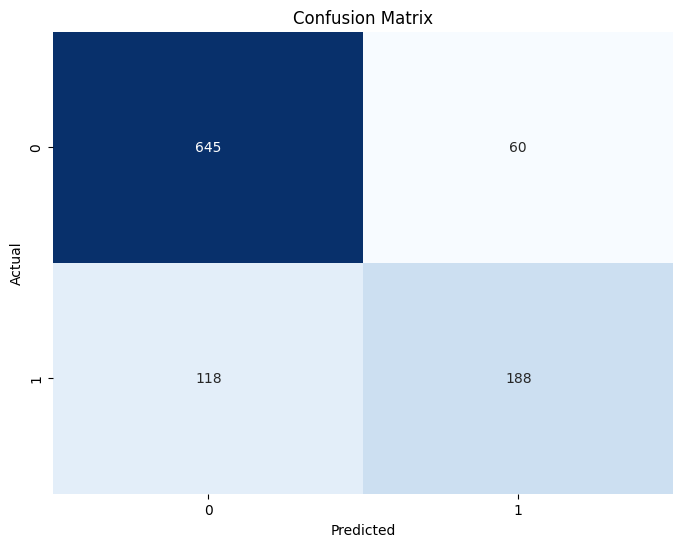

In [688]:
X = subscriptions_cleaned[["adnet", "service", "source", "attempt_charging", "operator", "country"]]
y = subscriptions_cleaned['is_declining']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

lg_model = LogisticRegression(C= 1, max_iter=100)
lg_model.fit(X_train, y_train)


y_pred_proba = lg_model.predict_proba(X_test)[:, 1]
y_pred = lg_model.predict(X_test)

acc_score = accuracy_score(y_test, y_pred)
prec_score = precision_score(y_test, y_pred)
rec_score = recall_score(y_test, y_pred)
f1_scr = f1_score(y_test, y_pred)

print(f"Model Accuracy      : {acc_score:.4f}")
print(f"Model Precision     : {prec_score:.4f}")
print(f"Model Recall Score  : {rec_score:.4f}")
print(f"Model F1 Score      : {f1_scr:.4f}")


cm = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

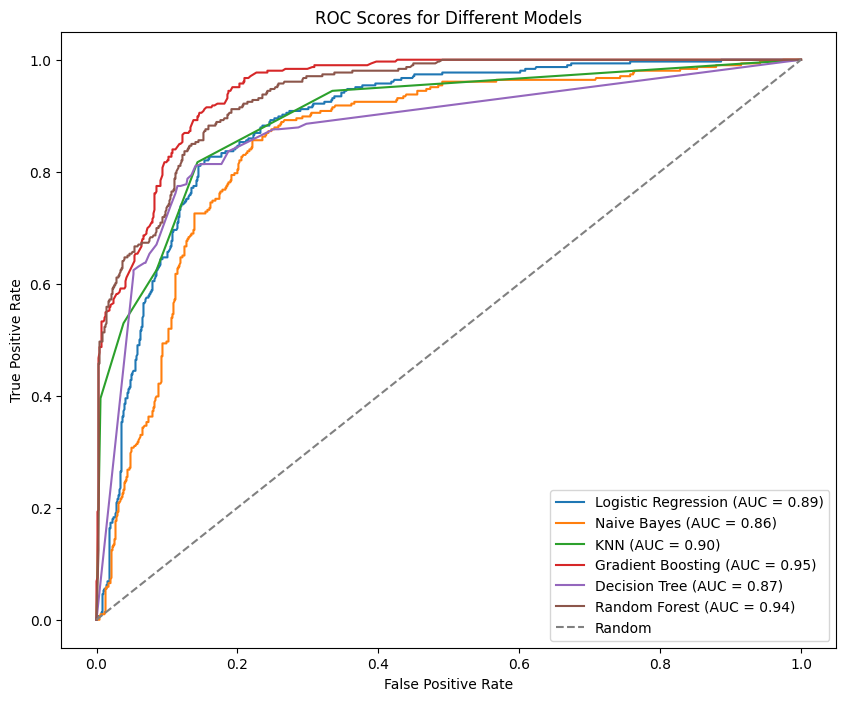

In [689]:
g_model = LogisticRegression(C= 1, max_iter=100)
naive_bayes = GaussianNB()
knn = KNeighborsClassifier(n_neighbors=5, algorithm="ball_tree")
gbc = GradientBoostingClassifier(loss= "log_loss")
dtc = DecisionTreeClassifier(max_depth=10, criterion="gini")
rfc = RandomForestClassifier(max_depth=10, criterion="gini")

models = [lg_model, naive_bayes, knn, gbc, dtc, rfc]
model_names = ['Logistic Regression', 'Naive Bayes', 'KNN', 'Gradient Boosting', 'Decision Tree', 'Random Forest']

plt.figure(figsize=(10, 8))

for model, name in zip(models, model_names):
    model.fit(X_train, y_train)
    y_pred_proba = model.predict_proba(X_test)[:, 1]  # Probabilities of the positive class
    fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
    roc_auc = auc(fpr, tpr)
    
    plt.plot(fpr, tpr, label=f'{name} (AUC = {roc_auc:.2f})')

plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Scores for Different Models')
plt.legend()
plt.show()